<a href="https://colab.research.google.com/github/Aamna-Khan-Git/Models/blob/main/Customer_Segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **CUSTOMER SEGMENTATION PROJECT**

## **SUBMITTED BY : AAMNA KHAN**
## Github link : [customer-segmentation](https://github.com/Aamna-Khan-Git/Models.git)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler, PowerTransformer
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import joblib

In [2]:
# Mounting drive
'''
from google.colab import drive
drive.mount('/content/drive')
'''

"\nfrom google.colab import drive\ndrive.mount('/content/drive')\n"

In [3]:
# Load dataset
d = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/labmentix/online_retail.csv')
d

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2022-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2022-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2023-12-09 12:50:00,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2023-12-09 12:50:00,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2023-12-09 12:50:00,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2023-12-09 12:50:00,4.15,12680.0,France


In [4]:
# Display dataset information
d.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    541909 non-null  object 
 1   StockCode    541909 non-null  object 
 2   Description  540455 non-null  object 
 3   Quantity     541909 non-null  int64  
 4   InvoiceDate  541909 non-null  object 
 5   UnitPrice    541909 non-null  float64
 6   CustomerID   406829 non-null  float64
 7   Country      541909 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 33.1+ MB


In [5]:
# Display data types of variables
d.dtypes

,0
InvoiceNo,object
StockCode,object
Description,object
Quantity,int64
InvoiceDate,object
UnitPrice,float64
CustomerID,float64
Country,object


In [6]:
# Check for null values
d.isnull().sum()

,0
InvoiceNo,0
StockCode,0
Description,1454
Quantity,0
InvoiceDate,0
UnitPrice,0
CustomerID,135080
Country,0


In [7]:
# Remove rows with null values and store new dataframe in d1
d1 = d.dropna()
d1

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2022-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2022-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2023-12-09 12:50:00,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2023-12-09 12:50:00,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2023-12-09 12:50:00,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2023-12-09 12:50:00,4.15,12680.0,France


In [8]:
# Recheck for missing values
d1.isnull().sum()

,0
InvoiceNo,0
StockCode,0
Description,0
Quantity,0
InvoiceDate,0
UnitPrice,0
CustomerID,0
Country,0


In [9]:
# Remove rows with 'C' in InvoiceNo and store new dataframe in d2
d2 = d1[~d1['InvoiceNo'].str.contains('C')]
d2

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2022-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2022-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2023-12-09 12:50:00,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2023-12-09 12:50:00,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2023-12-09 12:50:00,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2023-12-09 12:50:00,4.15,12680.0,France


In [10]:
# Filter out rows where Quantity or UnitPrice is less than or equal to 0
d3 = d2[(d2['Quantity'] > 0) & (d2['UnitPrice'] > 0)]
d3

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2022-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2022-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2023-12-09 12:50:00,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2023-12-09 12:50:00,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2023-12-09 12:50:00,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2023-12-09 12:50:00,4.15,12680.0,France


In [11]:
# Check if d3 contains rows with quantity and price less than or equal to zero
(d3['Quantity'] <= 0).any() or (d3['UnitPrice'] <= 0).any()

np.False_

In [12]:
# Checking for unique values
d3.nunique()

,0
InvoiceNo,18532
StockCode,3665
Description,3877
Quantity,301
InvoiceDate,17282
UnitPrice,440
CustomerID,4338
Country,37


In [13]:
# Displaying unique countries names with count of each
d3['Country'].value_counts()

,count
Country,
United Kingdom,354321
Germany,9040
France,8341
EIRE,7236
Spain,2484
Netherlands,2359
Belgium,2031
Switzerland,1841
Portugal,1462


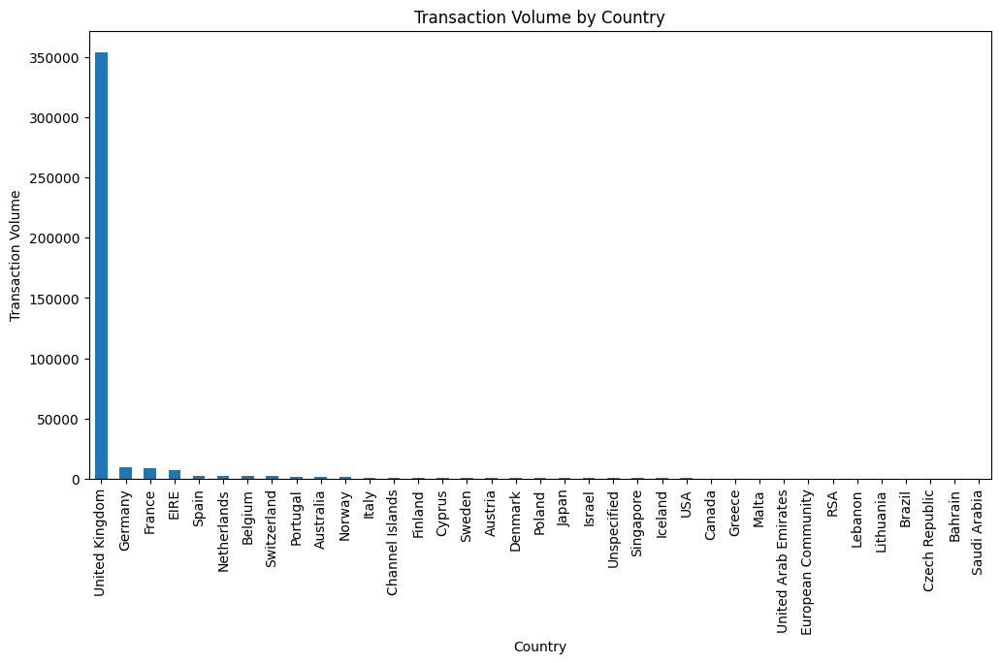

In [14]:
# Analysing and plotting transacion volume by country
tv = d3.groupby('Country')['InvoiceNo'].count().sort_values(ascending=False)
plt.figure(figsize=(12, 6)) # Adjust figure size for better readability
tv.plot(kind='bar')
plt.xlabel('Country') # Add x-axis label
plt.ylabel('Transaction Volume') # Add y-axis label
plt.title('Transaction Volume by Country') # Add title
plt.show()

In [15]:
# Identifying top-selling products
top_products = d3.groupby('Description')['Quantity'].sum().sort_values(ascending=False).head(10)
top_products

,Quantity
Description,
"PAPER CRAFT , LITTLE BIRDIE",80995
MEDIUM CERAMIC TOP STORAGE JAR,77916
WORLD WAR 2 GLIDERS ASSTD DESIGNS,54415
JUMBO BAG RED RETROSPOT,46181
WHITE HANGING HEART T-LIGHT HOLDER,36725
ASSORTED COLOUR BIRD ORNAMENT,35362
PACK OF 72 RETROSPOT CAKE CASES,33693
POPCORN HOLDER,30931
RABBIT NIGHT LIGHT,27202


/tmp/ipython-input-785066160.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d3['InvoiceDate'] = pd.to_datetime(d3['InvoiceDate'])


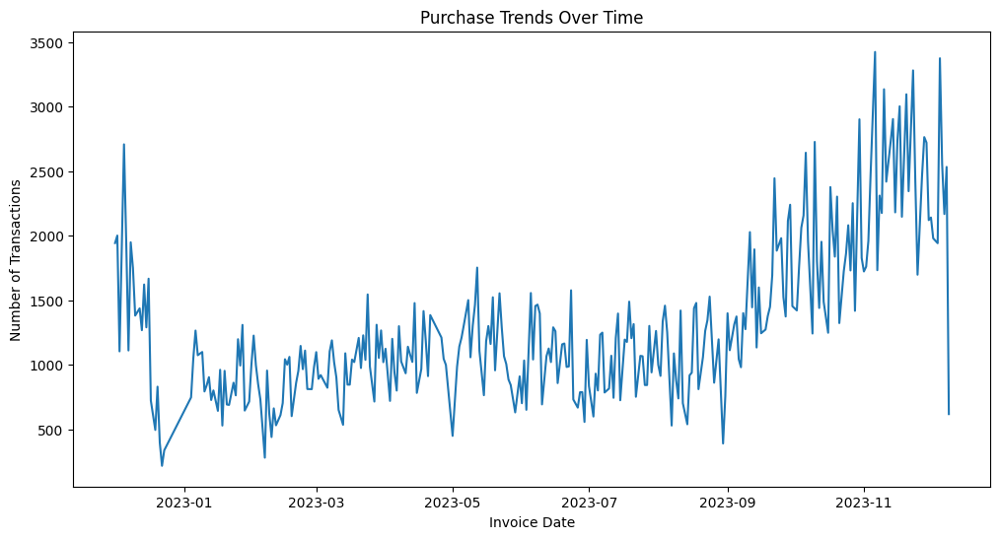

In [16]:
# Plotting purchase trends over time
d3['InvoiceDate'] = pd.to_datetime(d3['InvoiceDate'])
trends = d3.groupby(d3['InvoiceDate'].dt.date)['InvoiceNo'].count()
plt.figure(figsize=(12, 6))
trends.plot()
plt.xlabel('Invoice Date')
plt.ylabel('Number of Transactions')
plt.title('Purchase Trends Over Time')
plt.show()

/tmp/ipython-input-1803723142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d3['TotalPrice'] = TotalPrice


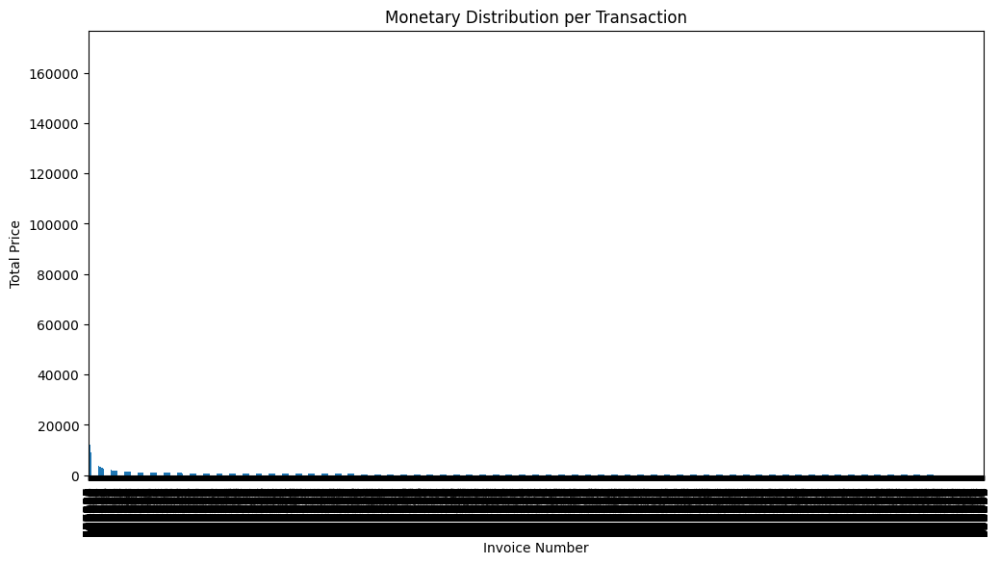

In [17]:
# Plot monetary distribution per transaction and customer
TotalPrice = d3['Quantity'] * d3['UnitPrice']
d3['TotalPrice'] = TotalPrice
md = d3.groupby('InvoiceNo')['TotalPrice'].sum().sort_values(ascending=False)
plt.figure(figsize=(12, 6))
md.plot(kind='bar')
plt.xlabel('Invoice Number')
plt.ylabel('Total Price')
plt.title('Monetary Distribution per Transaction')
plt.show()

Too many invoice numbers are causing overcrowding on the x axis, so let's just display the top 20 invoive numbers by total price.

/tmp/ipython-input-2961091210.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d3['TotalPrice'] = TotalPrice


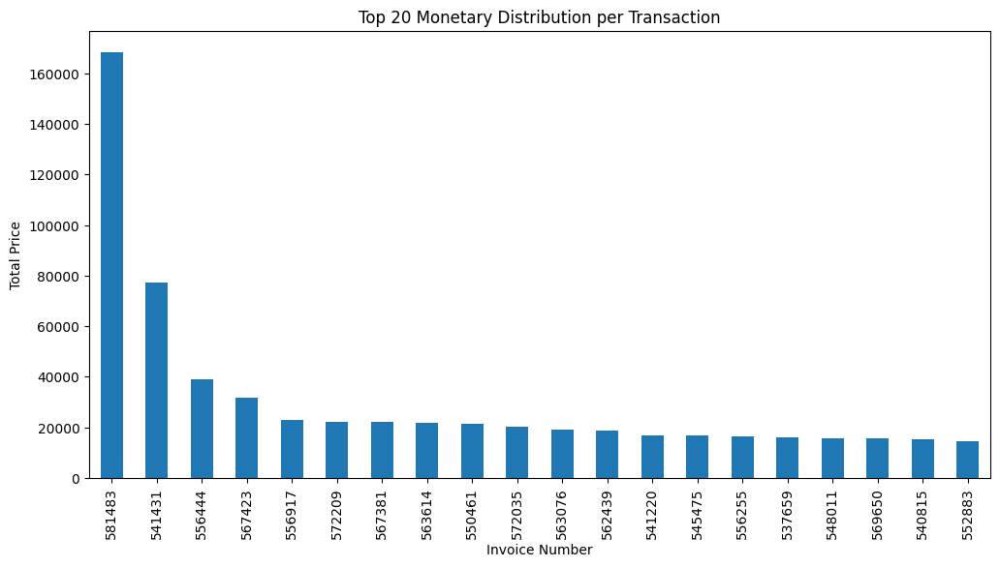

In [18]:
# Plot monetary distribution per transaction and customer
TotalPrice = d3['Quantity'] * d3['UnitPrice']
d3['TotalPrice'] = TotalPrice
md = d3.groupby('InvoiceNo')['TotalPrice'].sum().sort_values(ascending=False)
top_md = md.head(20)
plt.figure(figsize=(12, 6))
top_md.plot(kind='bar')
plt.xlabel('Invoice Number')
plt.ylabel('Total Price')
plt.title('Top 20 Monetary Distribution per Transaction')
plt.show()

In [19]:
# Calculating Recency
# Recency = Latest purchase date in dataset − Customer’s last purchase date
import pandas as pd

# Ensure 'InvoiceDate' is in datetime format
d3['InvoiceDate'] = pd.to_datetime(d3['InvoiceDate'])

# Reference date: 1 day after the most recent purchase
ref_date = d3['InvoiceDate'].max() + pd.Timedelta(days=1)

# Calculate Recency: difference between reference date and customer’s last purchase
recency_df = d3.groupby('CustomerID')['InvoiceDate'].max().reset_index()
recency_df['Recency'] = (ref_date - recency_df['InvoiceDate']).dt.days
recency_df.drop(columns='InvoiceDate', inplace=True)

# Drop existing Recency columns if they exist
d3 = d3.drop(columns=[col for col in d3.columns if 'Recency' in col], errors='ignore')

# Merge Recency back into original dataframe
d3 = pd.merge(d3, recency_df, on='CustomerID', how='left')

d3

/tmp/ipython-input-3068488674.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d3['InvoiceDate'] = pd.to_datetime(d3['InvoiceDate'])


,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,TotalPrice,Recency
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2022-12-01 08:26:00,2.55,17850.0,United Kingdom,15.30,372
1,536365,71053,WHITE METAL LANTERN,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2022-12-01 08:26:00,2.75,17850.0,United Kingdom,22.00,372
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372
...,...,...,...,...,...,...,...,...,...,...
397879,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2023-12-09 12:50:00,0.85,12680.0,France,10.20,1
397880,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2023-12-09 12:50:00,2.10,12680.0,France,12.60,1
397881,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2023-12-09 12:50:00,4.15,12680.0,France,16.60,1
397882,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2023-12-09 12:50:00,4.15,12680.0,France,16.60,1


In [20]:
# Calculating Frequency
# Frequency = Number of transactions per customer
freq = d3.groupby('CustomerID')['InvoiceNo'].nunique()
# Map the frequency back to the main DataFrame
d3['Frequency'] = d3['CustomerID'].map(freq)
d3

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,TotalPrice,Recency,Frequency
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2022-12-01 08:26:00,2.55,17850.0,United Kingdom,15.30,372,34
1,536365,71053,WHITE METAL LANTERN,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2022-12-01 08:26:00,2.75,17850.0,United Kingdom,22.00,372,34
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34
...,...,...,...,...,...,...,...,...,...,...,...
397879,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2023-12-09 12:50:00,0.85,12680.0,France,10.20,1,4
397880,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2023-12-09 12:50:00,2.10,12680.0,France,12.60,1,4
397881,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2023-12-09 12:50:00,4.15,12680.0,France,16.60,1,4
397882,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2023-12-09 12:50:00,4.15,12680.0,France,16.60,1,4


In [21]:
# Calculating Monetary
# Monetary = Total amount spent by customer = Quantity * UnitPrice
# This is just TotalPrice, which has already been calculated earlier
# Thus, we will just rename TotalPrice as Monetary
d3.rename(columns={'TotalPrice': 'Monetary'}, inplace=True)
d3

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Monetary,Recency,Frequency
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2022-12-01 08:26:00,2.55,17850.0,United Kingdom,15.30,372,34
1,536365,71053,WHITE METAL LANTERN,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2022-12-01 08:26:00,2.75,17850.0,United Kingdom,22.00,372,34
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34
...,...,...,...,...,...,...,...,...,...,...,...
397879,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2023-12-09 12:50:00,0.85,12680.0,France,10.20,1,4
397880,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2023-12-09 12:50:00,2.10,12680.0,France,12.60,1,4
397881,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2023-12-09 12:50:00,4.15,12680.0,France,16.60,1,4
397882,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2023-12-09 12:50:00,4.15,12680.0,France,16.60,1,4


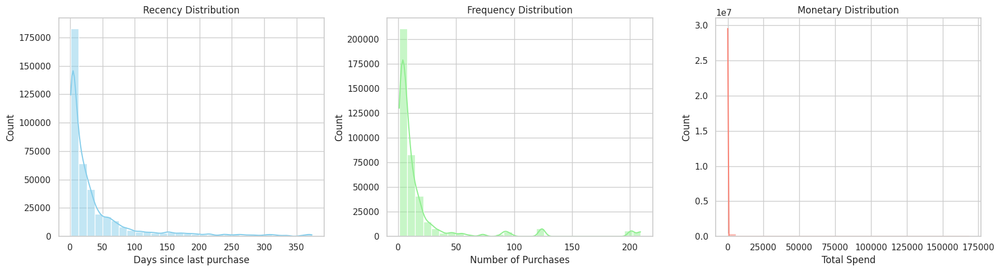

In [22]:
# Plotting RFM distributions
# Set plot style
sns.set(style='whitegrid')

# Create subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Plot Recency distribution
sns.histplot(d3['Recency'], bins=30, kde=True, ax=axes[0], color='skyblue')
axes[0].set_title('Recency Distribution')
axes[0].set_xlabel('Days since last purchase')

# Plot Frequency distribution
sns.histplot(d3['Frequency'], bins=30, kde=True, ax=axes[1], color='lightgreen')
axes[1].set_title('Frequency Distribution')
axes[1].set_xlabel('Number of Purchases')

# Plot Monetary distribution
sns.histplot(d3['Monetary'], bins=30, kde=True, ax=axes[2], color='salmon')
axes[2].set_title('Monetary Distribution')
axes[2].set_xlabel('Total Spend')

plt.tight_layout()
plt.show()

In [23]:
# Scaling Recency, Monetary and Frequency
# Standard scaling for Recency and Frequency
scaler = StandardScaler()
d3[['Recency_scaled', 'Frequency_scaled']] = scaler.fit_transform(d3[['Recency', 'Frequency']])

# Log transformation for Monetary
transformer = PowerTransformer(method='yeo-johnson')
d3['Monetary_scaled'] = transformer.fit_transform(d3[['Monetary']])
d3

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Monetary,Recency,Frequency,Recency_scaled,Frequency_scaled,Monetary_scaled
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2022-12-01 08:26:00,2.55,17850.0,United Kingdom,15.30,372,34,5.053688,0.407024,0.385956
1,536365,71053,WHITE METAL LANTERN,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34,5.053688,0.407024,0.639096
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2022-12-01 08:26:00,2.75,17850.0,United Kingdom,22.00,372,34,5.053688,0.407024,0.708102
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34,5.053688,0.407024,0.639096
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34,5.053688,0.407024,0.639096
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
397879,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2023-12-09 12:50:00,0.85,12680.0,France,10.20,1,4,-0.612869,-0.395535,0.020077
397880,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2023-12-09 12:50:00,2.10,12680.0,France,12.60,1,4,-0.612869,-0.395535,0.211351
397881,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2023-12-09 12:50:00,4.15,12680.0,France,16.60,1,4,-0.612869,-0.395535,0.458853
397882,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2023-12-09 12:50:00,4.15,12680.0,France,16.60,1,4,-0.612869,-0.395535,0.458853


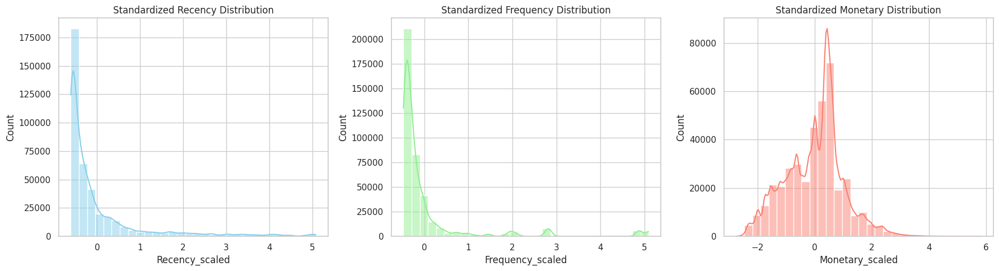

In [24]:
# Plotting scaled RFM distributions
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

sns.histplot(d3['Recency_scaled'], bins=30, kde=True, ax=axes[0], color='skyblue')
axes[0].set_title('Standardized Recency Distribution')

sns.histplot(d3['Frequency_scaled'], bins=30, kde=True, ax=axes[1], color='lightgreen')
axes[1].set_title('Standardized Frequency Distribution')

sns.histplot(d3['Monetary_scaled'], bins=30, kde=True, ax=axes[2], color='salmon')
axes[2].set_title('Standardized Monetary Distribution')

plt.tight_layout()
plt.show()


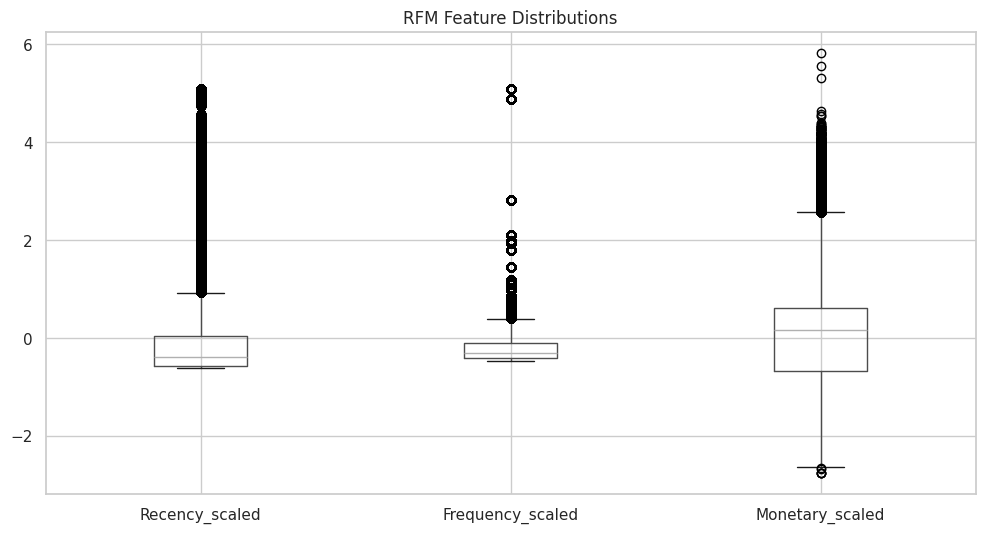

In [25]:
#Visualising RFM BoxPlot
plt.figure(figsize=(12, 6))
d3[['Recency_scaled', 'Frequency_scaled', 'Monetary_scaled']].boxplot()

# Add title
plt.title('RFM Feature Distributions')

# Show plot
plt.show()

Original shape: (397884, 14)
Shape after outlier removal: (310718, 14)


<Axes: >

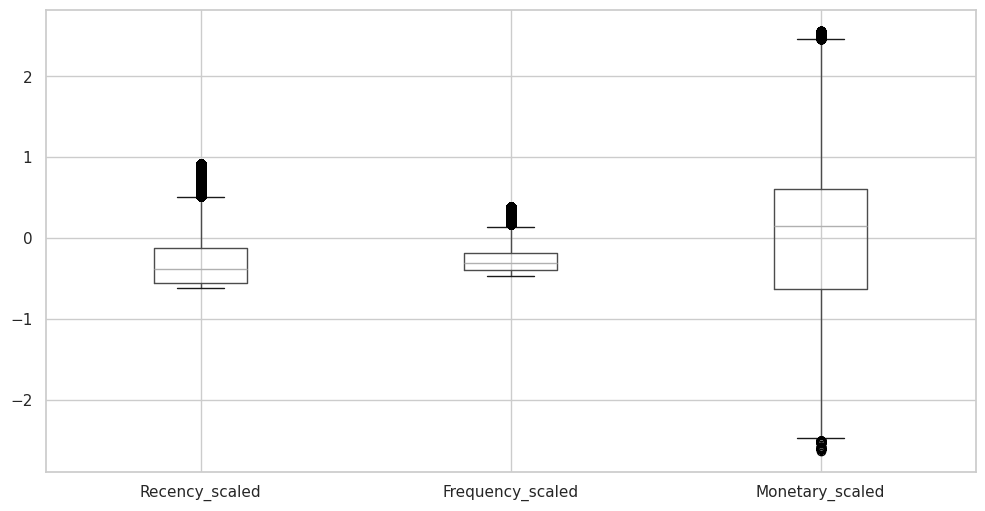

In [26]:
# Removing outliers using IQR
Q1 = d3[['Recency_scaled', 'Frequency_scaled', 'Monetary_scaled']].quantile(0.25)
Q3 = d3[['Recency_scaled', 'Frequency_scaled', 'Monetary_scaled']].quantile(0.75)
IQR = Q3 - Q1

# Define bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter out outliers
d4 = d3[
    (d3['Recency_scaled'] >= lower_bound['Recency_scaled']) & (d3['Recency_scaled'] <= upper_bound['Recency_scaled']) &
    (d3['Frequency_scaled'] >= lower_bound['Frequency_scaled']) & (d3['Frequency_scaled'] <= upper_bound['Frequency_scaled']) &
    (d3['Monetary_scaled'] >= lower_bound['Monetary_scaled']) & (d3['Monetary_scaled'] <= upper_bound['Monetary_scaled'])
]

print(f"Original shape: {d3.shape}")
print(f"Shape after outlier removal: {d4.shape}")
plt.figure(figsize=(12, 6))  # Width, Height (adjust as needed)
d4[['Recency_scaled', 'Frequency_scaled', 'Monetary_scaled']].boxplot()

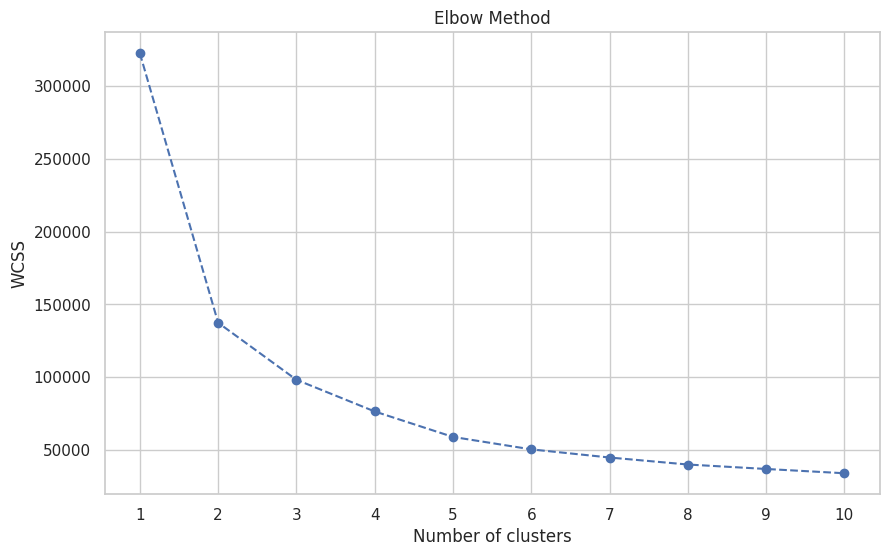

In [27]:
# Plotting Elbow curve for cluster selection
wcss = []
for i in range(1, 11): # Test for 1 to 10 clusters
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42, n_init=10) # Explicitly set n_init
    kmeans.fit(d4[['Recency_scaled', 'Frequency_scaled', 'Monetary_scaled']])
    wcss.append(kmeans.inertia_)

plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), wcss, marker='o', linestyle='--')
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.xticks(range(1, 11))
plt.grid(True)
plt.show()

In [28]:
# Store parameters in rfm_scaled
rfm_scaled = d4[['Recency_scaled', 'Frequency_scaled', 'Monetary_scaled']]
rfm_scaled

,Recency_scaled,Frequency_scaled,Monetary_scaled
9,-0.139383,-0.235023,1.470266
10,-0.139383,-0.235023,0.211351
11,-0.139383,-0.235023,0.211351
12,-0.139383,-0.235023,0.977247
13,-0.139383,-0.235023,-0.007012
...,...,...,...
397879,-0.612869,-0.395535,0.020077
397880,-0.612869,-0.395535,0.211351
397881,-0.612869,-0.395535,0.458853
397882,-0.612869,-0.395535,0.458853


In [29]:
# Calculate silhouette score on a smaller sample size rather than entire dataset because it was taking too long
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans

# Calculate silhouette scores for different numbers of clusters
silhouette_scores = {}
for k in [2, 3, 4]:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(rfm_scaled)
    # Calculate silhouette score on a smaller sample
    score = silhouette_score(rfm_scaled, kmeans.labels_, sample_size=5000)
    silhouette_scores[k] = score
    print(f"k={k}: Silhouette Score = {score:.2f}")

k=2: Silhouette Score = 0.49
k=3: Silhouette Score = 0.40
k=4: Silhouette Score = 0.36


/tmp/ipython-input-3484257759.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rfm_scaled['Cluster'] = kmeans.labels_


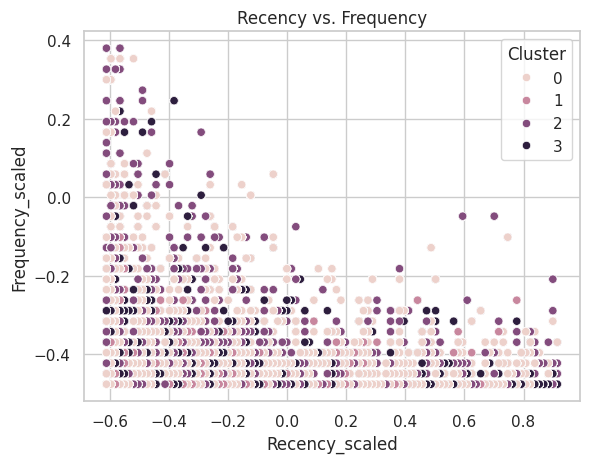

In [30]:
# Displaying scatter plot based on rfm_scaled
# Fit K-Means with k=4
kmeans = KMeans(n_clusters=4, random_state=42, n_init=10)
kmeans.fit(rfm_scaled)

# Add cluster labels to the DataFrame
rfm_scaled['Cluster'] = kmeans.labels_

sns.scatterplot(data=rfm_scaled, x='Recency_scaled', y='Frequency_scaled', hue='Cluster')
plt.title('Recency vs. Frequency')
plt.show()

/tmp/ipython-input-268201643.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rfm_scaled['Cluster'] = kmeans.labels_
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


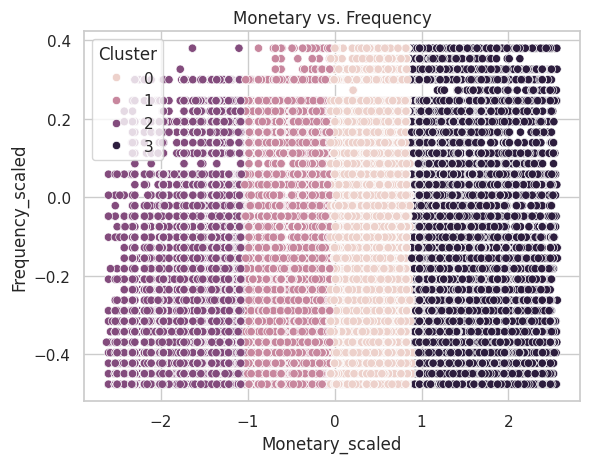

In [31]:
# Displaying scatter plot based on rfm_scaled
# Fit K-Means with k=4
kmeans = KMeans(n_clusters=4, random_state=42, n_init=10)
kmeans.fit(rfm_scaled)

# Add cluster labels to the DataFrame
rfm_scaled['Cluster'] = kmeans.labels_

sns.scatterplot(data=rfm_scaled, x='Monetary_scaled', y='Frequency_scaled', hue='Cluster')
plt.title('Monetary vs. Frequency')
plt.show()


In [55]:
# Dropping cluster column from rfm_scaled
rfm = rfm_scaled.drop(columns= 'Cluster', axis=1)
rfm

,Recency_scaled,Frequency_scaled,Monetary_scaled
9,-0.139383,-0.235023,1.470266
10,-0.139383,-0.235023,0.211351
11,-0.139383,-0.235023,0.211351
12,-0.139383,-0.235023,0.977247
13,-0.139383,-0.235023,-0.007012
...,...,...,...
397879,-0.612869,-0.395535,0.020077
397880,-0.612869,-0.395535,0.211351
397881,-0.612869,-0.395535,0.458853
397882,-0.612869,-0.395535,0.458853


/tmp/ipython-input-1153443521.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rfm_scaled['Cluster'] = kmeans.labels_
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


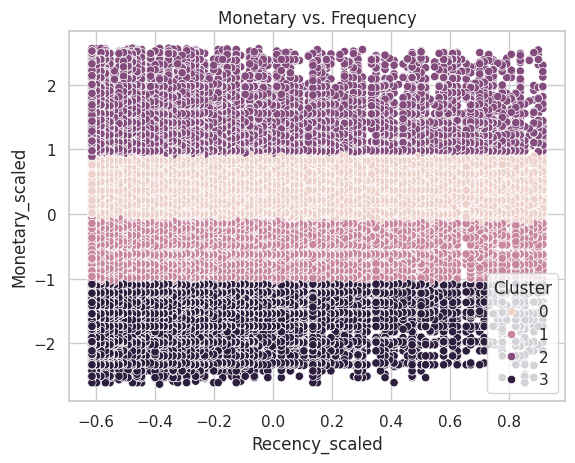

In [32]:
# Displaying scatter plot based on rfm_scaled
# Fit K-Means with k=4
kmeans = KMeans(n_clusters=4, random_state=42, n_init=10)
kmeans.fit(rfm)



# Add cluster labels to the DataFrame
rfm_scaled['Cluster'] = kmeans.labels_

sns.scatterplot(data=rfm_scaled, x='Recency_scaled', y='Monetary_scaled', hue='Cluster')
plt.title('Monetary vs. Frequency')
plt.show()

In [64]:
from sklearn.cluster import KMeans
import joblib

# Only use scaled features (NOT the DataFrame with 'Cluster' column)
features = rfm[['Recency_scaled', 'Frequency_scaled', 'Monetary_scaled']]

# Fit the model
kmeans = KMeans(n_clusters=4, random_state=42, n_init=10)
kmeans.fit(features)

# Save the fitted model
joblib.dump(kmeans, "rfm_cluster_model.pkl")


['rfm_cluster_model.pkl']

In [57]:
# Display rfm_scaled
rfm

,Recency_scaled,Frequency_scaled,Monetary_scaled,Cluster
9,-0.139383,-0.235023,1.470266,3
10,-0.139383,-0.235023,0.211351,0
11,-0.139383,-0.235023,0.211351,0
12,-0.139383,-0.235023,0.977247,3
13,-0.139383,-0.235023,-0.007012,0
...,...,...,...,...
397879,-0.612869,-0.395535,0.020077,0
397880,-0.612869,-0.395535,0.211351,0
397881,-0.612869,-0.395535,0.458853,0
397882,-0.612869,-0.395535,0.458853,0


In [58]:
# Add all rfm_scaled columns to d3 and drop the ones that already exist
d3 = d3.drop(columns=['Recency_scaled', 'Frequency_scaled', 'Monetary_scaled'])
dn = rfm_scaled.drop(columns = 'Cluster')
d3 = pd.concat([d3, dn], axis=1)
d3



,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Monetary,Recency,Frequency,Cluster,Recency_scaled,Frequency_scaled,Monetary_scaled
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2022-12-01 08:26:00,2.55,17850.0,United Kingdom,15.30,372,34,NaN,NaN,NaN,NaN
1,536365,71053,WHITE METAL LANTERN,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34,NaN,NaN,NaN,NaN
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2022-12-01 08:26:00,2.75,17850.0,United Kingdom,22.00,372,34,NaN,NaN,NaN,NaN
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34,NaN,NaN,NaN,NaN
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2022-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,372,34,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
397879,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2023-12-09 12:50:00,0.85,12680.0,France,10.20,1,4,0.0,-0.612869,-0.395535,0.020077
397880,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2023-12-09 12:50:00,2.10,12680.0,France,12.60,1,4,0.0,-0.612869,-0.395535,0.211351
397881,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2023-12-09 12:50:00,4.15,12680.0,France,16.60,1,4,0.0,-0.612869,-0.395535,0.458853
397882,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2023-12-09 12:50:00,4.15,12680.0,France,16.60,1,4,0.0,-0.612869,-0.395535,0.458853


In [36]:
#!pip install plotly

In [65]:

import plotly.express as px
import pandas as pd

# Assuming your RFM data has 'Recency', 'Frequency', 'Monetary' and 'Cluster' columns
# First, map clusters to your labels
segment_map = {
    0: 'High-Value (High R, High F, High M)',
    1: 'Regular (Medium F, Medium M)',
    2: 'Occasional (Low F, Low M, Older R)',
    3: 'At-Risk (High R, Low F, Low M)'
}

# Apply labels to your dataframe
rfm['Segment'] = rfm['Cluster'].map(segment_map)

# Create interactive 3D plot
fig = px.scatter_3d(
    rfm,
    x='Recency_scaled',
    y='Frequency_scaled',
    z='Monetary_scaled',
    color='Segment',
    color_discrete_map={
        'High-Value (High R, High F, High M)': '#636EFA',  # Blue
        'Regular (Medium F, Medium M)': '#EF553B',          # Red
        'Occasional (Low F, Low M, Older R)': '#00CC96',    # Green
        'At-Risk (High R, Low F, Low M)': '#AB63FA'         # Purple
    },
    hover_data={
        'Recency_scaled': ':.1f',
        'Frequency_scaled': ':.1f',
        'Monetary_scaled': ':.1f',
        'Segment': True,
        'Cluster': True
    },
    title='Interactive 3D RFM Segments',
    height=800,
    labels={
        'Recency_scaled': 'Recency (days)',
        'Frequency_scaled': 'Frequency',
        'Monetary_scaled': 'Monetary ($)'
    }
)

# Enhance the visualization
fig.update_traces(
    marker=dict(size=5, opacity=0.8, line=dict(width=0.5, color='DarkSlateGrey')),
    selector=dict(mode='markers')
)

# Improve layout
fig.update_layout(
    legend=dict(
        title='Segment',
        yanchor='top',
        y=0.99,
        xanchor='left',
        x=0.01
    ),
    scene=dict(
        xaxis_title='Recency',
        yaxis_title='Frequency',
        zaxis_title='Monetary'
    )
)

fig.show()

  StockCode  Similarity_Score
0     21175             0.750
1     21733             0.659
2     82552             0.644
3     82551             0.642
4     23288             0.631


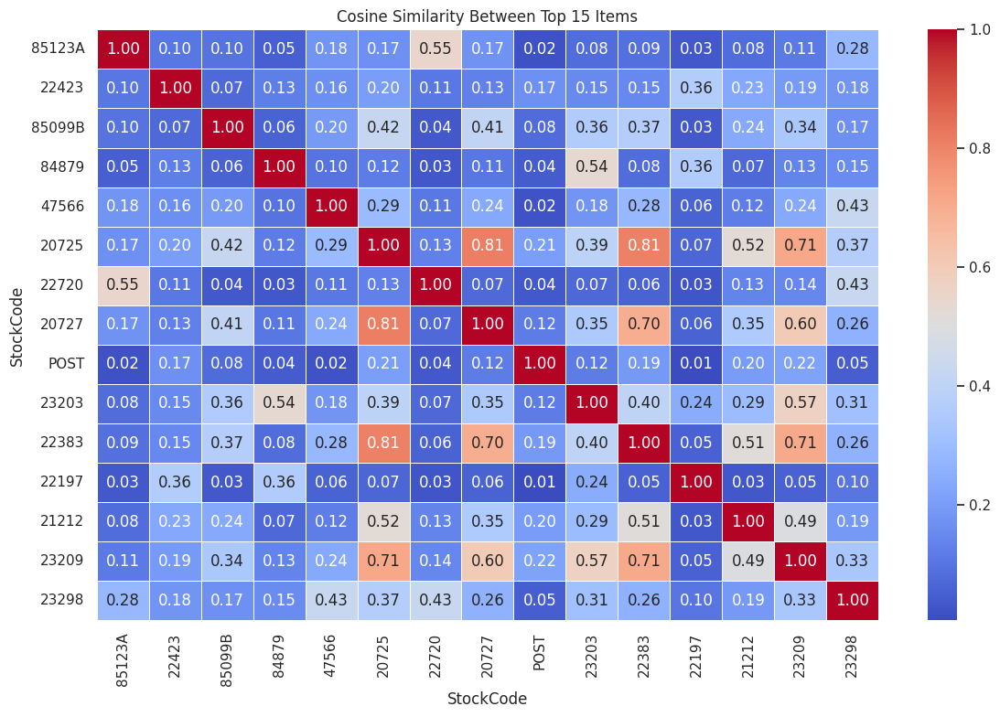

In [70]:
# ---------------------------------------------------
# STEP 1: Prepare Data (Customer-Product Matrix)
# ---------------------------------------------------
transactions = pd.DataFrame({
    'CustomerID': d3['CustomerID'],
    'StockCode': d3['StockCode'],
    'Quantity': d3['Quantity']
})

# Create customer-product matrix
customer_product_matrix = transactions.pivot_table(
    index='CustomerID',
    columns='StockCode',
    values='Quantity',
    aggfunc='sum',
    fill_value=0
)

# Convert to sparse matrix
sparse_matrix = csr_matrix(customer_product_matrix.values)

# ---------------------------------------------------
# STEP 2: Compute Item Similarities
# ---------------------------------------------------
item_similarity = cosine_similarity(sparse_matrix.T)  # item-item similarity
item_similarity_df = pd.DataFrame(
    item_similarity,
    index=customer_product_matrix.columns,
    columns=customer_product_matrix.columns
)

# Save similarity matrix for Streamlit app
joblib.dump(item_similarity_df, "item_similarity_matrix.pkl")

# STEP 3: Recommendation Function (for testing)
# ---------------------------------------------------
def get_recommendations(product_code, n_recommendations=5):
    if product_code not in item_similarity_df.index:
        return f"Product code '{product_code}' not found."

    similarities = item_similarity_df[product_code].sort_values(ascending=False)
    recommendations = similarities.iloc[1:n_recommendations+1].index.tolist()
    scores = similarities.iloc[1:n_recommendations+1].values.round(3)

    return pd.DataFrame({
        'StockCode': recommendations,
        'Similarity_Score': scores
    })

# ---------------------------------------------------
# STEP 4: Plot Similarity Matrix (Top N Items)
# ---------------------------------------------------
def plot_similarity_matrix(top_n=20):
    top_items = transactions['StockCode'].value_counts().head(top_n).index
    subset = item_similarity_df.loc[top_items, top_items]

    plt.figure(figsize=(12, 8))
    sns.heatmap(subset, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
    plt.title(f"Cosine Similarity Between Top {top_n} Items")
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

# STEP 5: Test usage
print(get_recommendations('85123A'))
plot_similarity_matrix(top_n=15)

In [74]:
def find_stockcodes_by_name(product_name):
    matches = d3[d3['Description'].str.contains(product_name, case=False, na=False)]
    results = matches[['StockCode', 'Description']].drop_duplicates().reset_index(drop=True)
    return results if not results.empty else None


def get_product_recommendations_from_input():
    """
    Asks user to input a product name, finds matching products,
    and shows top 5 similar products based on cosine similarity.
    """
    product_name = input("Enter product name: ").strip()
    matches = find_stockcodes_by_name(product_name)

    if matches is None:
        return

    if len(matches) == 1:
        selected_code = matches.loc[0, 'StockCode']
        print(f"\nFound 1 match: {matches.loc[0, 'Description']} (StockCode: {selected_code})")

    else:
        print("\nMultiple matches found. Choose the correct product:")
        for idx, row in matches.iterrows():
            print(f"{idx}: {row['Description']} (StockCode: {row['StockCode']})")

        try:
            selection = int(input("\nEnter the number of the product you want to use: "))
            selected_code = matches.loc[selection, 'StockCode']
        except:
            print("Invalid selection.")
            return

    print(f"\nShowing recommendations for: {selected_code}")
    recommendations = get_recommendations(selected_code)
    print(recommendations)


# -----------------------------
# Run the Recommendation System
# -----------------------------
get_product_recommendations_from_input()


Enter product name: CHILDRENS CUTLERY DOLLY GIRL

Found 1 match: CHILDRENS CUTLERY DOLLY GIRL  (StockCode: 23254)

Showing recommendations for: 23254
  StockCode  Similarity_Score
0     23256             0.945
1     23390             0.944
2     23345             0.940
3     22712             0.940
4     23389             0.940


In [75]:
from google.colab import files
files.download("rfm_cluster_model.pkl")
files.download("item_similarity_matrix.pkl")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>